# Final Project

### Group Name: Motor City Motor Equity
### Group Member: Akshay Jalluri

Since the code for the final project crashes when I run it all at once, I saved a geojson file in the middle which shows the underserved and overserved transit areas, and I will be uploading that geojson file onto here and the continuing it. The rest of the code leading up to this is in Group_Project/Part 1 of Final Project.ipynb. This way, the code will run much faster. The geojson file is called service.geojson and it is attached within this folder Group_Project/data/service.geojson.

Plotting the graph that concluded the code for the midterm project, to which we will be conducting spatial analysis on.

In [2]:
# Importing all the libraries

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import geopandas as gpd
from shapely.geometry import Polygon

import contextily as ctx
import plotly.express as px

In [3]:
# Making the service geojson file into a geodatframe
service = gpd.read_file("data/service.geojson")

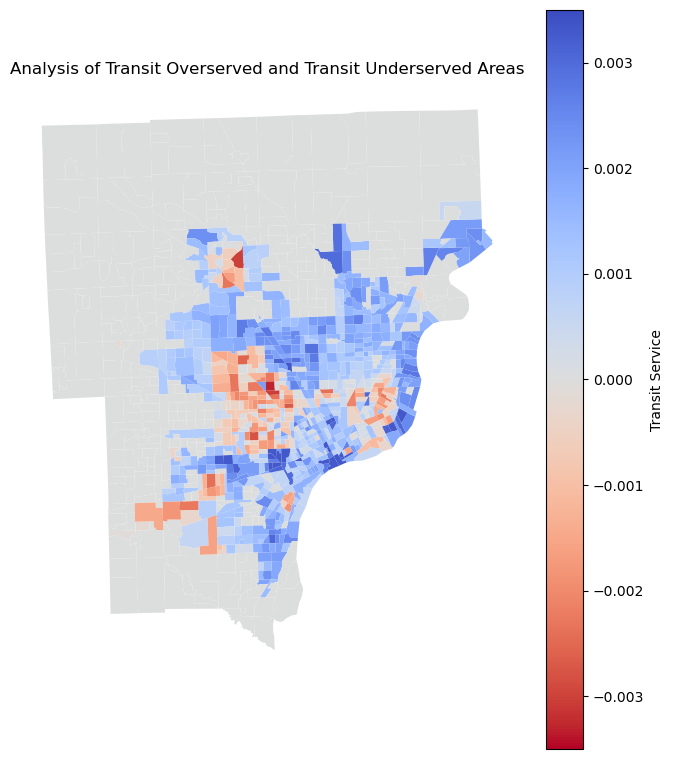

In [4]:
# This is plotting the service plot from the previous project
ax = service.plot(figsize=(8, 9.6), 
             column='Residual', 
             legend=True, cmap='coolwarm_r', 
             legend_kwds={"label": "Transit Service"},
             vmin=-0.0035, vmax=0.0035)
plt.title('Analysis of Transit Overserved and Transit Underserved Areas')

ax.axis('off')            # Turning off the axis for a cleaner look

plt.show()

Now creating it in Plotly express so that it looks better and we can add that to our website. Also the interactiveness of it helps with understanding the data a little more for the user.

/tmp/ipykernel_125/1370856368.py:9: UserWarning:

Geometry is in a geographic CRS. Results from 'centroid' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.


/tmp/ipykernel_125/1370856368.py:10: UserWarning:

Geometry is in a geographic CRS. Results from 'centroid' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.




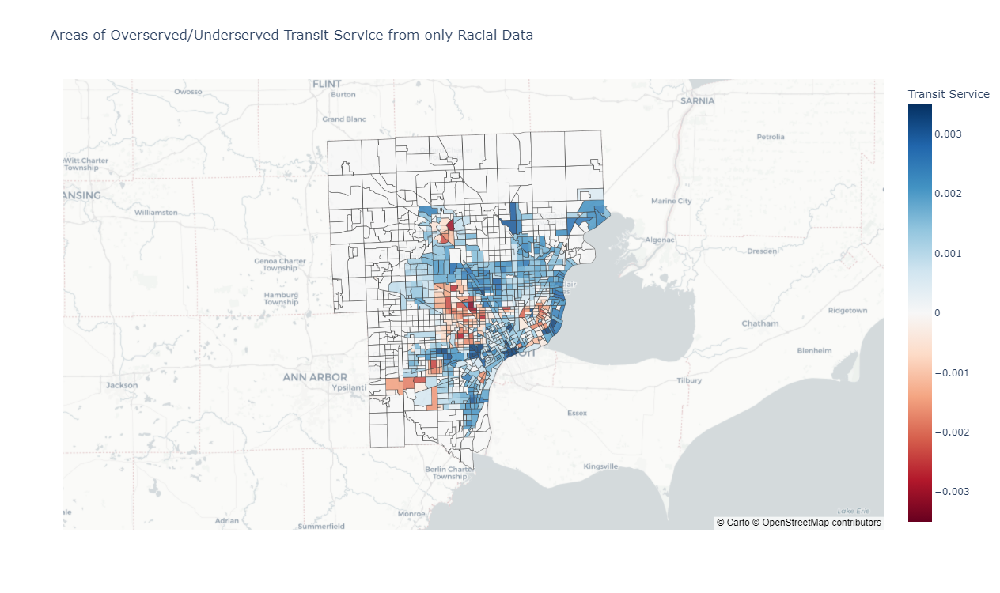

In [28]:
# Creating the Plotly Express map
fig = px.choropleth_mapbox(service,                                          # Our geodataframe we will be plotting
                           geojson=service.geometry,                         # Plotting the geometry of the map from the geometry column
                           locations=service.index,                          # Plotting the locations of the map from the indices
                           color='Residual',                                 # The colors of the map will come from the 'Residual' column of geodataframe because that is our indication of transit service
                           color_continuous_scale='RdBu',                    # This is the color scale we will be using
                           range_color=(-0.0035, 0.0035),                    # The reason to manually do this is because we want 0 to be right in the middle so that those not included will be grayed out
                           mapbox_style="carto-positron",                    # Basemap style
                           center={"lat": service.centroid.y.mean(),         # When the map first opens, we want the map to be at the middle of our map data
                                   "lon": service.centroid.x.mean()},
                           zoom=8,                                           # How zoomed in we want our data to be
                           labels={'Residual': 'Transit Service'},           # This is our colorbar scale title
                           title='Areas of Overserved/Underserved Transit Service from only Racial Data',        # Map title
                           width=1000,                                       # Set the width to 1000 pixels
                           height=750,                                       # Set the height to 750 pixels
                           opacity = 0.85                                    # We reduced the opacity so that a user can see the basemap underneath the colored tiles as well      
                          )

fig.update_traces(marker_line_width=0.5)                                     # Adjusting the line thickness
fig.update_layout(coloraxis_colorbar_title='Transit Service')                # Update the color scale label
fig.show()                                                                   # Show the plot

In [29]:
fig.write_html("transitService.html")

Overall, this is a very informative map that shows the analysis of overserved and underserved transit areas. However, from last time the only variable that was considered was racial disparity, and we were trying to determines areas that transit is overserved and underserved only based on this racial equity. Races who tend to use transit more should be better served by transit than those who don't. However in reality, race isn't the only thing that determines how much transit should be in place. In areas where there is a lot more jobs, there should be more transit options even though the demographics of those actually living there might not indicate it. For example, in our previous analysis, downtown Detroit was shown as a heavily transit overserved place because not many minorities live there. However, with how many job opportunities are in downtown Detroit, the number of transit options is actually justified. That is why it is important to take job/employment opportunities within a census tract into account, which is what we will do in the next section of our analysis. 

## Incorporating Job Hotspots using Distance-Based Kernel Weights (Spatial Statistics)

We have the data for population in each census tract, we also have data on number of jobs in each census tract. We could use this data to create a gravity model to see which work flows are the highest. We can use the results to update whether a particular area is underserved or overserved because right now it is only based on race, not employment opportunities.

In [20]:
!pip install pysal  --quiet                 # We must force install the pysal library to run spatial weight analysis

In [21]:
# We are using kernel spatial weight analysis. I learned this from https://geographicdata.science/book/notebooks/04_spatial_weights.html
from pysal.lib import cg as geometry
from pysal.lib import weights

The reason why we have to do spatial weights instead of just finiding a open datasource that contains this information is because I was not able to find one online. There was an online Leaflet map from SEMCOG (Southeast Michigan Council of Governments) Employment Density Map, the equivalent of SCAG in Southern California; however, the datasource was not open, and even after emailing them, I was not able to get a hold of them. So instead, I came up with another idea. Jobs typically tend to cluster in several areas around a metro area and radiate out from there, with less job density expanding from that. I used that property, along with what we learned in class about spatial autocorrelation and learning from online to try to replicate a dataset that can take job density in particular areas into account. I identified the job hotspots within the metro-Detroit area within DDOT and SMART bus system networks and then mapped it out spatially. Below is the code to help me achieve that.

NameError: name 'percentile_bins' is not defined

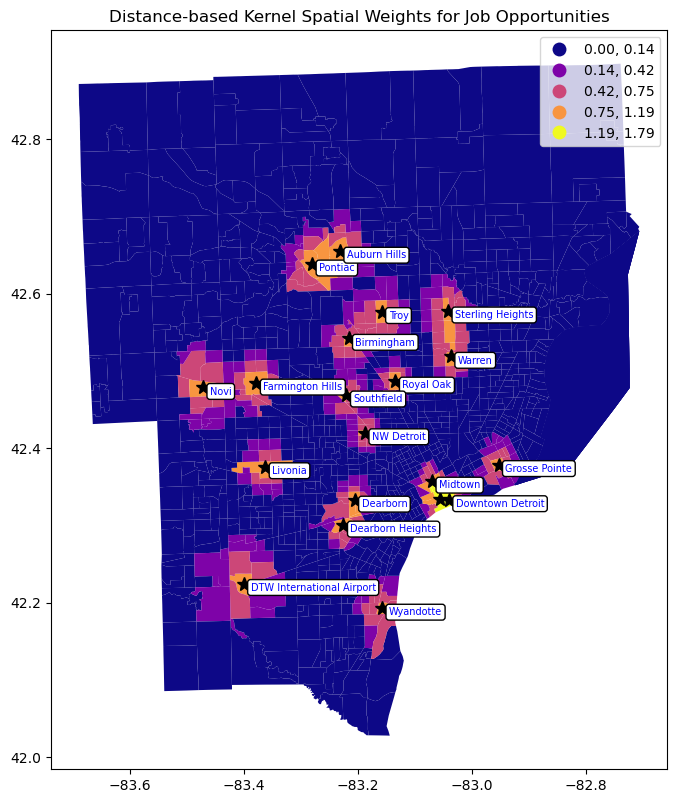

In [22]:
# Building weights with adaptive bandwidth
w_adaptive = weights.distance.Kernel.from_dataframe(service, fixed=False, k=25)

# Creating full matrix version of weights
full_matrix, ids = w_adaptive.full()

# For each of the job hotspots, we indicated the row number of that FIPS location in the service geodataframe and complied it in a list. Look at the Custom-made FIPS to Row Indices calculator I built below
# Within service geodataframe, row 383 & 424 is downtown Detroit, 682 is Royal Oak, 422 is Midtown, 543 is Dearborn, 409 for Dearborn again, 172 for DTW, 914 for Pontiac, 105 for Auburn Hills, 327 for Troy, 1036 for Warren, 429 for Southfield, 146 for NW Detroit, 468 for Grosse Pointe, 584 for Wyandotte, 57 for Livonia, 501 for Farmington Hills, 902 for Birmingham, 965 for Sterling Heights, 210 for Novi     
jobloc = [383, 424, 682, 422, 543, 409, 172, 914, 105, 327, 1036, 429, 146, 468, 584, 57, 501, 902, 965, 210]
locname = ['Downtown Detroit', '', 'Royal Oak', 'Midtown', 'Dearborn Heights', 'Dearborn', 'DTW International Airport', 'Pontiac', 'Auburn Hills', 'Troy', 'Warren', 'Southfield', 'NW Detroit', 'Grosse Pointe', 'Wyandotte', 'Livonia', 'Farmington Hills', 'Birmingham', 'Sterling Heights', 'Novi'] 

service['total_weight'] = 0                                  # Creating a new column in the service GeoDataFrame which is where the weights will go into
for i in range(len(jobloc)):
    service['total_weight'] += full_matrix[jobloc[i]]        # Adding the weight values from each of the cities into their respective locations in the service geodataframe

# Setting up figure and axis
fig, ax = plt.subplots(figsize=(8, 9.6))

# Plotting the total_weight column for all tracts
service.plot("total_weight", cmap="plasma", ax=ax, legend=True, label="Combined Kernel Maps", scheme='NaturalBreaks')

# Adding centroid markers of focal tracts and city label markers for all the locations
for i in range(len(jobloc)):
    centroid = service.loc[jobloc[i], 'geometry'].centroid
    ax.plot(centroid.x, centroid.y, marker="*", color="k", markersize=10)
    ax.annotate(locname[i], (centroid.x, centroid.y), xytext=(5, -5), textcoords="offset points", color="blue", fontsize=7, bbox=dict(boxstyle="round,pad=0.3", fc="white", ec="black"))

# Setting titles
ax.set_title("Distance-based Kernel Spatial Weights for Job Opportunities")

# Setting the color bar because we are doing Natural Breaks to make the colors pop out more
cbar = plt.colorbar(plt.cm.ScalarMappable(norm=percentile_bins, cmap="plasma"), ax=ax)
cbar.set_label('Total Weight', rotation=270, labelpad=15)

# Adding legend
ax.legend()

# Turning off axis
ax.axis('off')

# Displaying the plot
plt.show()

As you can see, here is the map of the job hotspots within metro-Detroit. The spatial weights of each of these census tracts will adjust the Residual value from the previous graph in order to make a more accurate map of which areas are overserved and underserved by transit. The code cell below is what I used to see which row indices a particular census tract is in. It helped me a lot with determining which residual values I will eventually need to update.

-----------------------------
### Custom-made FIPS to Row Indices Calculator

In [23]:
# Assuming `gdf` is your GeoDataFrame and `desired_fips` is the FIPS number you want to find
desired_fips = '26125136602'

# Check if the FIPS number exists in the GeoDataFrame
if desired_fips in service["FIPS"].values:
    row_index = service.index[service["FIPS"] == desired_fips].tolist()[0]              # Get the index where the FIPS number is located
    print(f"The FIPS number {desired_fips} is in row index: {row_index}")               # Prints out our row number which I will then identify job hotspots from
else:
    print(f"The FIPS number {desired_fips} does not exist in the GeoDataFrame.")        # If FIPS number is not in geodataframe, it will output that it it doesn't exist within geodatafram

The FIPS number 26125136602 is in row index: 210


--------------------------------

Below is the formula I used to calculate the new residuals from the old one. 500 was obtained from trial-and-error to create the most accurate map to reality.

In [24]:
# We are subtracting them because the more total weight a location had, the more jobs it had so the transit serving that place is not very overserved
service['Residual_new'] = service['Residual'] - (service['total_weight'] / 500)

Text(0.5, 1.0, 'Analysis of Transit Overserved and Transit Underserved Areas')

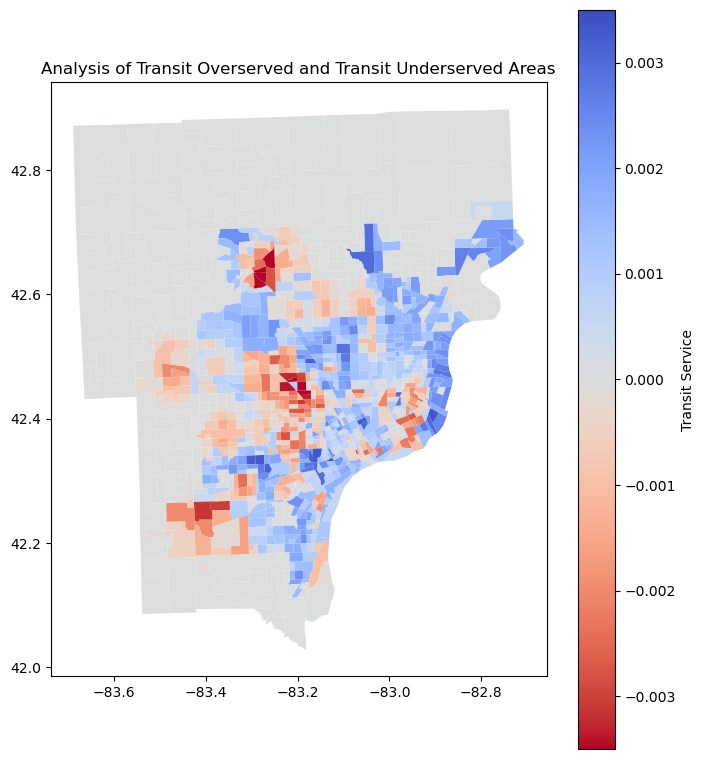

In [25]:
# Plotting the new transit overserved/underserved analysis graph by taking both race & employment locations into account
service.plot(figsize=(8, 9.6),                                                # Determines the size of the plot
             column='Residual_new',                                           # We are plotting the 'Residual_new' column now instead of 'Residual' column from last time 
             legend=True, cmap='coolwarm_r',                                  # Displaying legend and using red to blue color scale. the "_r" is to indicate blue on top red on bottom
             legend_kwds={"label": "Transit Service"},                        # The label of the colorbar
             vmin=-0.0035, vmax=0.0035)                                       # The reason to manually do this is because we want 0 to be right in the middle so that those not included will be grayed out
plt.title('Analysis of Transit Overserved and Transit Underserved Areas')     # Title of map

From this map above you can see differences from the map from even before we incorporated job data. This map is a much more accurate in determining which areas have overserved transit and which places have underserved transit. Looking back at the downtown Detroit example, you can see that it is ~ 0, meaning that it is close to perfectly served, unlike previously which classfied as heavily overserved. 

Now creating it in Plotly express so that it looks better and we can add that to our website. Also the interactiveness of it helps with understanding the data a little more for the user.

/tmp/ipykernel_125/3817657775.py:9: UserWarning:

Geometry is in a geographic CRS. Results from 'centroid' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.


/tmp/ipykernel_125/3817657775.py:10: UserWarning:

Geometry is in a geographic CRS. Results from 'centroid' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.




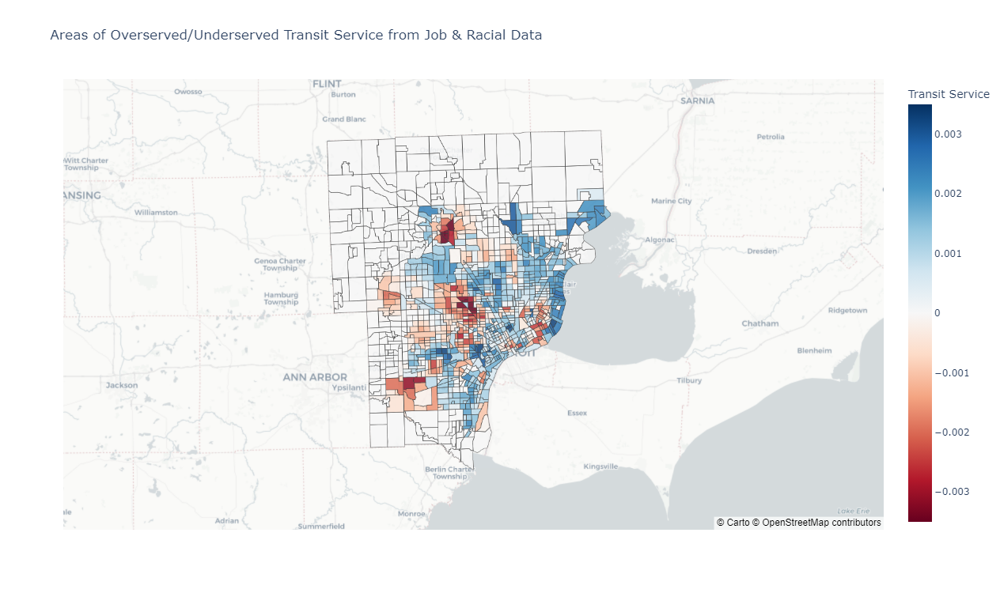

In [26]:
# Creating the Plotly Express map
fig = px.choropleth_mapbox(service,                                          # Our geodataframe we will be plotting
                           geojson=service.geometry,                         # Plotting the geometry of the map from the geometry column
                           locations=service.index,                          # Plotting the locations of the map from the indices
                           color='Residual_new',                             # The colors of the map will come from the 'Residual_new' column of geodataframe because that is our indication of transit service
                           color_continuous_scale='RdBu',                    # This is the color scale we will be using
                           range_color=(-0.0035, 0.0035),                    # The reason to manually do this is because we want 0 to be right in the middle so that those not included will be grayed out
                           mapbox_style="carto-positron",                    # Basemap style
                           center={"lat": service.centroid.y.mean(),         # When the map first opens, we want the map to be at the middle of our map data
                                   "lon": service.centroid.x.mean()},
                           zoom=8,                                           # How zoomed in we want our data to be
                           labels={'Residual_new': 'Transit Service'},       # This is our colorbar scale title
                           title='Areas of Overserved/Underserved Transit Service from Job & Racial Data',        # Map title
                           width=1000,                                       # Set the width to 1000 pixels
                           height=750,                                       # Set the height to 750 pixels
                           opacity = 0.85                                    # We reduced the opacity so that a user can see the basemap underneath the colored tiles as well      
                          )

fig.update_traces(marker_line_width=0.5)                                     # Adjusting the line thickness so that it doesn't clutter the map
fig.update_layout(coloraxis_colorbar_title='Transit Service')                # Update the color scale label
fig.show()                                                                   # Show the plot

In [27]:
fig.write_html("transitService_withjobs.html")                           # Saving the plot as an .html file

## Global Spatial Autocorrelation

Spatial Lag analysis considers the values of neighboring locations to determine its own value. This approach aligns with real-world dynamics, where nearby locations tend to exhibit stronger relationships than those farther apart. Applying spatial lag analysis to our transit service map results in a smoothed representation, enhancing the predictability of underserved or overserved areas across metro-Detroit.

In [31]:
# Importing the libraries to conduct graphical analysis
import esda                                                     # This is the library that contains the statistical analysis tools for spatial autocorrelation
from esda.moran import Moran, Moran_Local                       # We only need the Moran tools from that because that is what we will use

import splot                                                    # This library will help us plot these statistical analyses
from splot.esda import moran_scatterplot, plot_moran, lisa_cluster,plot_moran_simulation         # These are the specific aspects of the library that we will need

import libpysal as lps                                          # This library helps us calculate spatial weight

In [32]:
# Calculating spatial weight
wq =  lps.weights.KNN.from_dataframe(service,k=8)

# Row-standardization
wq.transform = 'r'

### Spatial Lag

Text(0.5, 1.0, 'Analysis of Transit Overserved and Transit Underserved Areas')

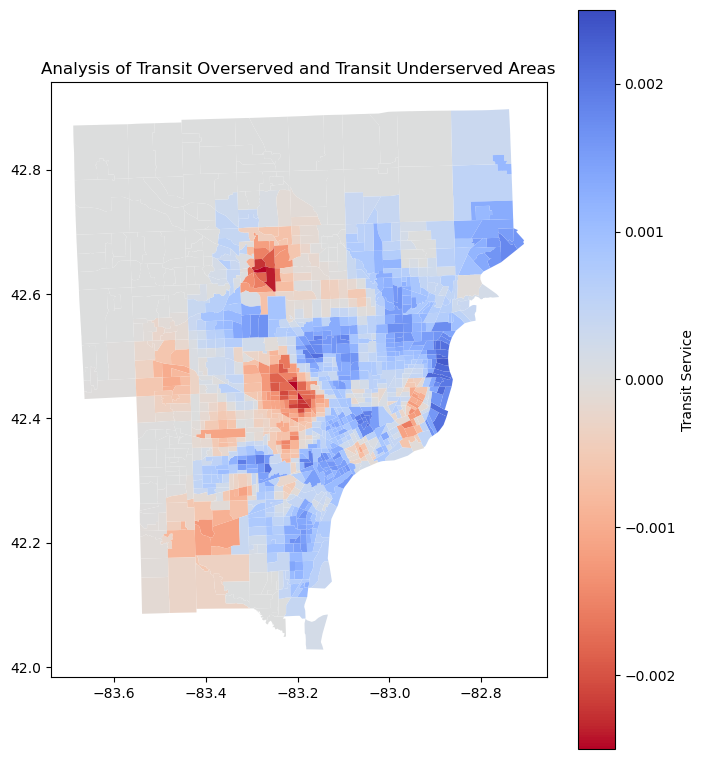

In [33]:
# Creating a new column for spatial lag
service['Residual_new_lag'] = lps.weights.lag_spatial(wq, service['Residual_new'])

# Plotting the new map
service.plot(figsize=(8, 9.6),                                                # Determines the size of the plot
             column='Residual_new_lag',                                       # We are plotting the 'Residual_new' column now instead of 'Residual' column from last time 
             legend=True, cmap='coolwarm_r',                                  # Displaying legend and using red to blue color scale. the "_r" is to indicate blue on top red on bottom
             legend_kwds={"label": "Transit Service"},                        # The label of the colorbar
             vmin=-0.0035, vmax=0.0035)                                       # The reason to manually do this is because we want 0 to be right in the middle so that those not included will be grayed out
plt.title('Analysis of Transit Overserved and Transit Underserved Areas')     # Title of map

(-83.7386116, -82.6567924, 41.98444945, 42.941021549999995)

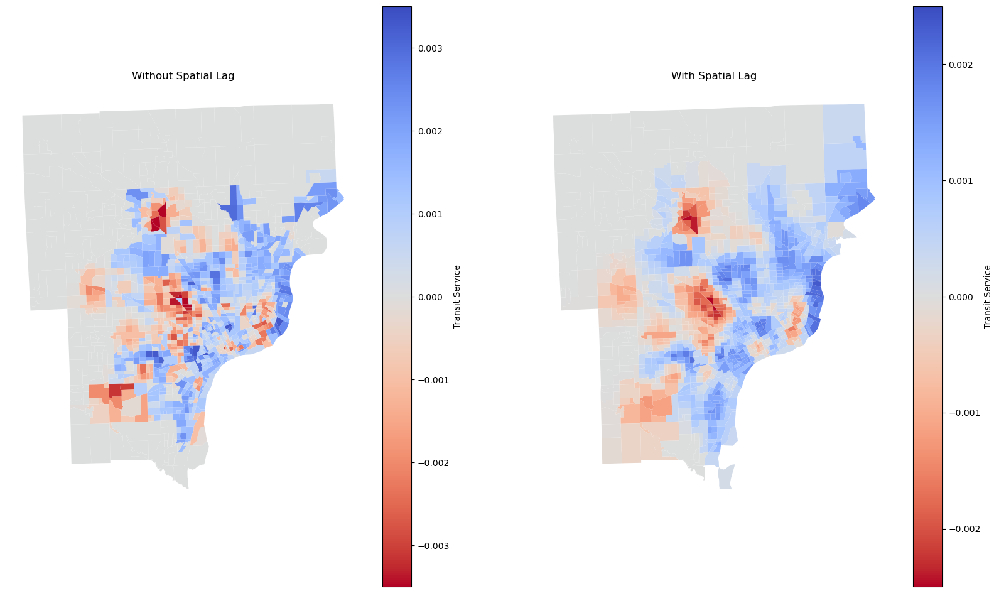

In [34]:
# Creating side-by-side plots of without spatial lag vs with spatial lag
fig, ax = plt.subplots(1, 2, figsize=(20, 12))                      # Determines the size of the plot

# Without Lag
service.plot(ax = ax[0],                                             # This is the left subplot of the graph
             column='Residual_new',                                  # We are plotting the 'Residual_new' column now instead of 'Residual' column from last time
             legend=True, cmap='coolwarm_r',                         # Displaying legend and using red to blue color scale. the "_r" is to indicate blue on top red on bottom
             legend_kwds={"label": "Transit Service"},               # The label of the colorbar
             vmin=-0.0035, vmax=0.0035)                              # The reason to manually do this is because we want 0 to be right in the middle so that those not included will be grayed out
ax[0].set_title('Without Spatial Lag')                               # Title of map
ax[0].axis("off")                                                    # Turning off axes for asthetics

# With Lag
service.plot(ax = ax[1],                                             # This is the right subplot of the graph
             column='Residual_new_lag',                              # We are plotting the 'Residual_new' column now instead of 'Residual' column from last time
             legend=True, cmap='coolwarm_r',                         # Displaying legend and using red to blue color scale. the "_r" is to indicate blue on top red on bottom
             legend_kwds={"label": "Transit Service"},               # The label of the colorbar
             vmin=-0.0025, vmax=0.0025)                              # The reason to manually do this is because we want 0 to be right in the middle so that those not included will be grayed out
ax[1].set_title('With Spatial Lag')                                  # Title of map
ax[1].axis("off")                                                    # Turning off axes for asthetics   

From using spatial lag, it makes the map cleaner and gives more correlation between census tracts than without spatial lag. Trends are better identified and this is much closer to reality as two places that are closer to eachother are more related to eachother than places that are further away from eachother. Spatial lag takes that into account, thus making it a much better map for analysis.

/tmp/ipykernel_125/1121734844.py:9: UserWarning:

Geometry is in a geographic CRS. Results from 'centroid' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.


/tmp/ipykernel_125/1121734844.py:10: UserWarning:

Geometry is in a geographic CRS. Results from 'centroid' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.




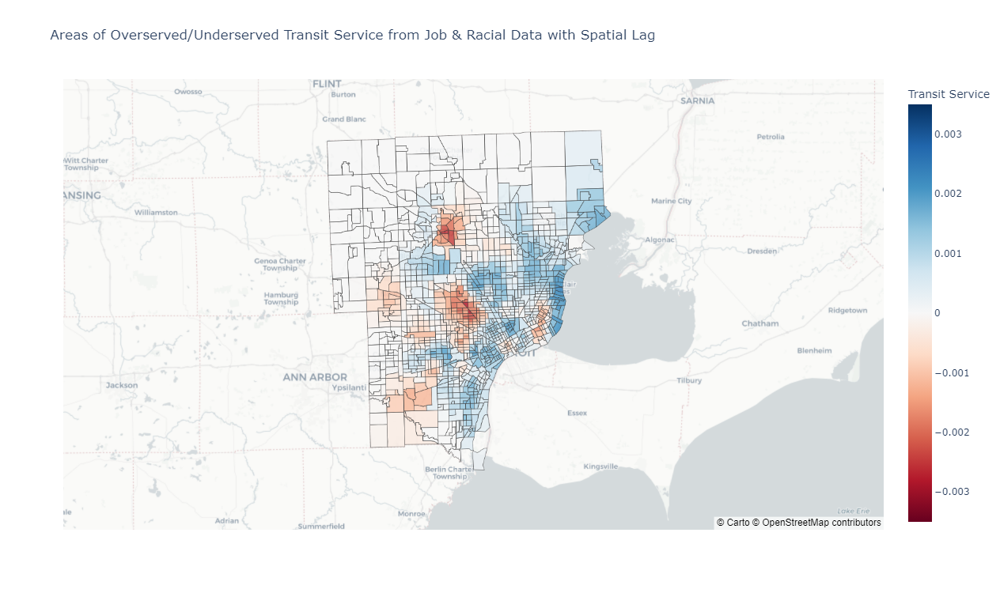

In [35]:
# Creating the Plotly Express map
fig = px.choropleth_mapbox(service,                                          # Our geodataframe we will be plotting
                           geojson=service.geometry,                         # Plotting the geometry of the map from the geometry column
                           locations=service.index,                          # Plotting the locations of the map from the indices
                           color='Residual_new_lag',                         # The colors of the map will come from the 'Residual_new_lag' column of geodataframe because that is our indication of transit service
                           color_continuous_scale='RdBu',                    # This is the color scale we will be using
                           range_color=(-0.0035, 0.0035),                    # The reason to manually do this is because we want 0 to be right in the middle so that those not included will be grayed out
                           mapbox_style="carto-positron",                    # Basemap style
                           center={"lat": service.centroid.y.mean(),         # When the map first opens, we want the map to be at the middle of our map data
                                   "lon": service.centroid.x.mean()},
                           zoom=8,                                           # How zoomed in we want our data to be
                           labels={'Residual_new_lag': 'Transit Service'},   # This is our colorbar scale title
                           title='Areas of Overserved/Underserved Transit Service from Job & Racial Data with Spatial Lag',        # Map title
                           width=1000,                                       # Set the width to 1000 pixels
                           height=750,                                       # Set the height to 750 pixels
                           opacity = 0.85                                    # We reduced the opacity so that a user can see the basemap underneath the colored tiles as well      
                          )

fig.update_traces(marker_line_width=0.5)                                     # Adjusting the line thickness so that it doesn't clutter the map
fig.update_layout(coloraxis_colorbar_title='Transit Service')                # Update the color scale label
fig.show()                                                                   # Show the plot

In [36]:
fig.write_html("transitService_withjobs_withlag.html")                      # Saving the map as an .html file

## Moran's Plot

Moran's Plot provides a quantitative measure of spatial correlations. This is used by the measure of global autocorrelation, where a positive value will indicate that higher values tend to be closer to higher values like clusters, and a negative value will indicate that higher values tend to be closer to lower values and vice versa (like a chess board).

In [44]:
# Before we do Moran's Plot, we first need to drop all the missing values. We can just put placement median values in place.
missing_values = service['Residual_new'].isnull().sum                               # Gets all the rows where the 'Residual_new' value is missing
service['Residual_new'].fillna(service['Residual_new'].median(), inplace=True)      # Drops those rows

# Now we can get the Moran's I value
y = service.Residual_new                                                            # Gets the new list of Residual_new values (with the missing ones dropped) and names it y
moran = Moran(y, wq)                                                                # The wq refers back to the spatial weight calculation wq = lps.weights.KNN.from_dataframe(service,k=8)
moran.I                                                                             # Print's out the Moran's I statistic

0.5184520052193462

The value of 0.52 is a pretty high Moran's value which means there is a strong positive autocorrelation, so it is clear which parts of metro-Detroit have underserved transit and which parts have overserved transit.

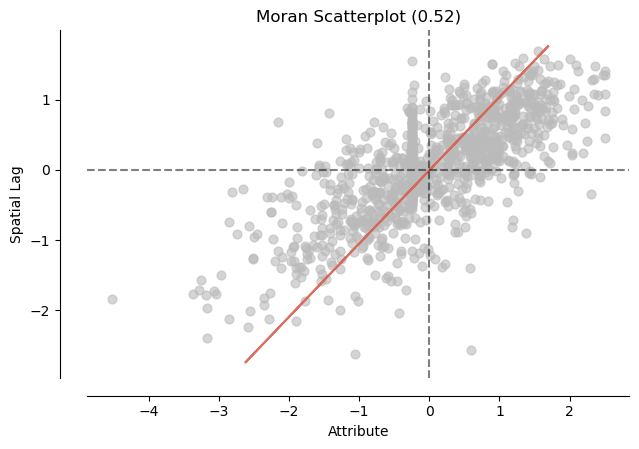

In [45]:
# Plotting a scatterplot
fig, ax = moran_scatterplot(moran, aspect_equal=True)
plt.show()

Now we have to calculate the significance of the Moran's I value

/opt/conda/lib/python3.11/site-packages/splot/_viz_esda_mpl.py:354: FutureWarning:



`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.




(<Figure size 700x700 with 1 Axes>,
 <Axes: title={'center': 'Reference Distribution'}, xlabel='Moran I: 0.52', ylabel='Density'>)

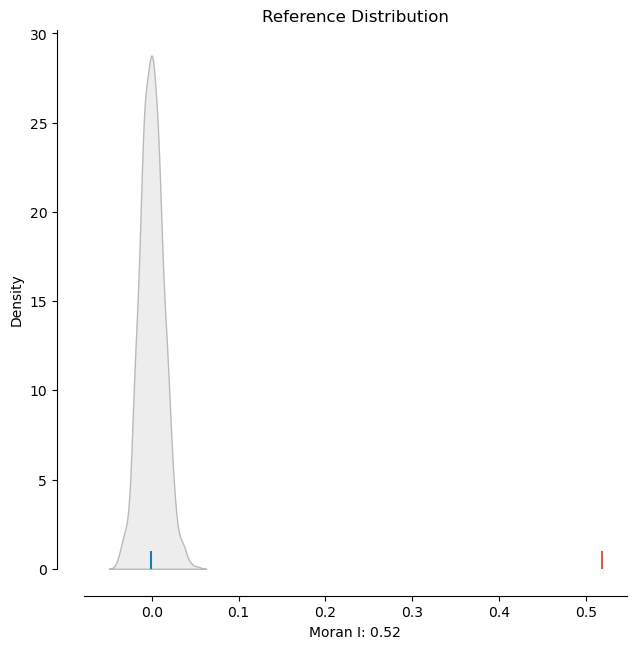

In [46]:
plot_moran_simulation(moran,aspect_equal=False)                                              # Running the simulation to calculate a cdf distribution of the simlations run. This helps us find the p-value

As you see here, all the values are very clumped up around the 0.001, meaning that there is an absolute certain chance that those values is not random at all. In all the simulations run (999 simulations is standard not a single one or only 1 failed). This is a very good sign, as it shows that our correlations is not random, and it makes out spatial autocorrelation much stronger. This statistic is important in giving us confidence that the areas we identified as overserved and underserved are actually indeed overserved and underserved.

In [47]:
# Computing the p-value
moran.p_sim

0.001

This is a very low value, so the probability of this being just random is so low that it becomes statistically significant. This makes the fact that there indeed are areas in metro-Detroit that are overserved and those that are underserved more evident.

## Moran's Local Scatterplot

Now let's plot the results in a Moran's Local Scatter plot. This will help us really visualize what the Moran's value of 0.52 means and helps us see how many census tracts are positively spatially autocorrelated and how many are negatively spatially autocorrelated. We will indicate the 4 quadrents of the Moran's Local Scatterplot as LL, LH, HL, and HH. LL are the census tracts with a low transit service value and are also surrounded by low value census tracts. LH are the census tracts with a low transit service value but surrounded by high value census tracts. HL are the census tracts with a high transit service value but surrounded by low value census tracts. HH are the census tracts with a high transit service value and are also surrounded by high value census tracts. More values in the LL and HH quadrants indicates higher Moran's value and a strongr positive autocorrelation. By choosing a low value like p = 0.01, we can see which places are the most overserved or most underserved (beware that the colors are flipped for this one, red indicates overserved and blue indicates underserved).

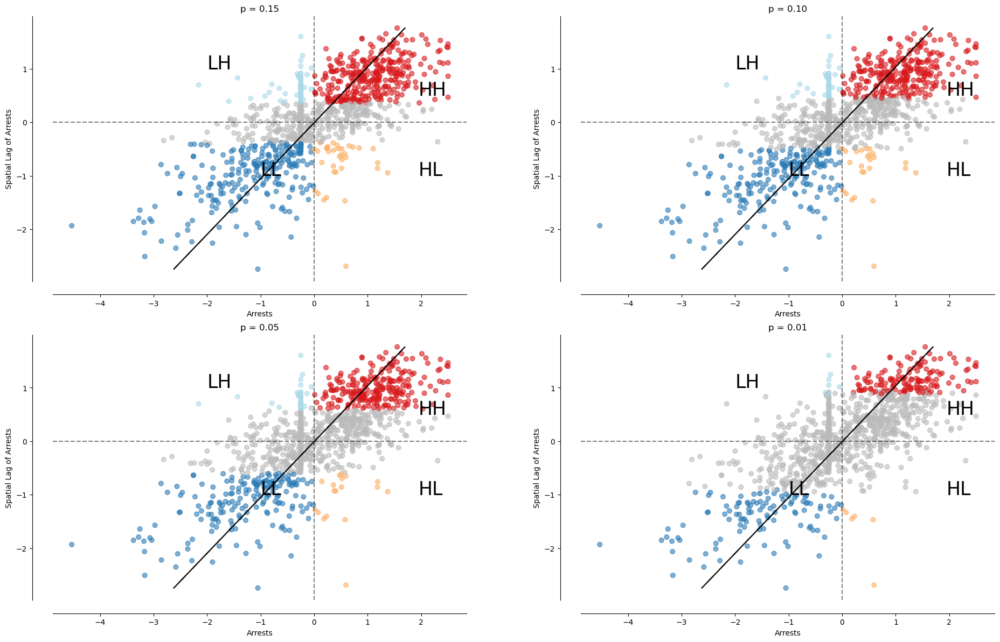

In [48]:
# Calculating local moran values
lisa = esda.moran.Moran_Local(y, wq)


# Creating 2x2 subplots
fig, ((ax1, ax2), (ax3, ax4)) = plt.subplots(2, 2, figsize=(20, 12))



# Plotting it for p = 0.15
moran_scatterplot(lisa, ax=ax1, p=0.15)                                  # Plotting the Moran's scatterplot in the top-left poistion for p=0.15. It will only color the points that pass that
ax1.set_xlabel("Arrests")                                                # x-axis label
ax1.set_ylabel('Spatial Lag of Arrests')                                 # y-axis label
ax1.set_title('p = 0.15')                                                # title of the graph
# add some labels
ax1.text(1.95, 0.5, "HH", fontsize=25)                                   # Indicates HH (High Near High) census tracts. Overserved census tracts near overserved census tracts
ax1.text(1.95, -1, "HL", fontsize=25)                                    # Indicates HL (High Near Low) census tracts. Overserved census tracts near underserved census tracts
ax1.text(-2, 1, "LH", fontsize=25)                                       # Indicates LH (Low Near High) census tracts. Underserved census tracts near overserved census tracts
ax1.text(-1, -1, "LL", fontsize=25)                                      # Indicates LL (Low Near Low) census tracts. Underserved census tracts near underserved census tracts



# Plotting it for p = 0.10
moran_scatterplot(lisa, ax=ax2, p=0.10)                                  # Plotting the Moran's scatterplot in the top-left poistion for p=0.10. It will only color the points that pass that
ax2.set_xlabel("Arrests")                                                # x-axis label
ax2.set_ylabel('Spatial Lag of Arrests')                                 # y-axis label
ax2.set_title('p = 0.10')                                                # title of the graph
# add some labels
ax2.text(1.95, 0.5, "HH", fontsize=25)                                   # Indicates HH (High Near High) census tracts. Overserved census tracts near overserved census tracts
ax2.text(1.95, -1, "HL", fontsize=25)                                    # Indicates HL (High Near Low) census tracts. Overserved census tracts near underserved census tracts
ax2.text(-2, 1, "LH", fontsize=25)                                       # Indicates LH (Low Near High) census tracts. Underserved census tracts near overserved census tracts
ax2.text(-1, -1, "LL", fontsize=25)                                      # Indicates LL (Low Near Low) census tracts. Underserved census tracts near underserved census tracts




# Plotting it for p = 0.05
moran_scatterplot(lisa, ax=ax3, p=0.05)                                  # Plotting the Moran's scatterplot in the top-left poistion for p=0.05. It will only color the points that pass that
ax3.set_xlabel("Arrests")                                                # x-axis label
ax3.set_ylabel('Spatial Lag of Arrests')                                 # y-axis label
ax3.set_title('p = 0.05')                                                # title of the graph
# add some labels
ax3.text(1.95, 0.5, "HH", fontsize=25)                                   # Indicates HH (High Near High) census tracts. Overserved census tracts near overserved census tracts
ax3.text(1.95, -1, "HL", fontsize=25)                                    # Indicates HL (High Near Low) census tracts. Overserved census tracts near underserved census tracts
ax3.text(-2, 1, "LH", fontsize=25)                                       # Indicates LH (Low Near High) census tracts. Underserved census tracts near overserved census tracts
ax3.text(-1, -1, "LL", fontsize=25)                                      # Indicates LL (Low Near Low) census tracts. Underserved census tracts near underserved census tracts



# Plotting it for p = 0.01
moran_scatterplot(lisa, ax=ax4, p=0.01)                                  # Plotting the Moran's scatterplot in the top-left poistion for p=0.01. It will only color the points that pass that
ax4.set_xlabel("Arrests")                                                # x-axis label
ax4.set_ylabel('Spatial Lag of Arrests')                                 # y-axis label
ax4.set_title('p = 0.01')                                                # title of the graph
# add some labels
ax4.text(1.95, 0.5, "HH", fontsize=25)                                   # Indicates HH (High Near High) census tracts. Overserved census tracts near overserved census tracts
ax4.text(1.95, -1, "HL", fontsize=25)                                    # Indicates HL (High Near Low) census tracts. Overserved census tracts near underserved census tracts
ax4.text(-2, 1, "LH", fontsize=25)                                       # Indicates LH (Low Near High) census tracts. Underserved census tracts near overserved census tracts
ax4.text(-1, -1, "LL", fontsize=25)                                      # Indicates LL (Low Near Low) census tracts. Underserved census tracts near underserved census tracts


plt.tight_layout()                                                       # So that it can fit all the graphs
plt.show()

In the graph above you can see how the p-value can change how many dots are colored on the grpah. The higher the p-value is, the more dots are colored. The lower the p-value is, the less dots are colored. Only the ones that show the most spatial autocorrelation are colored, whether that is a positive one or a negative one. The census tracts who are most surrounded by other census tracts.

### Spatial Autocorrelation Maps

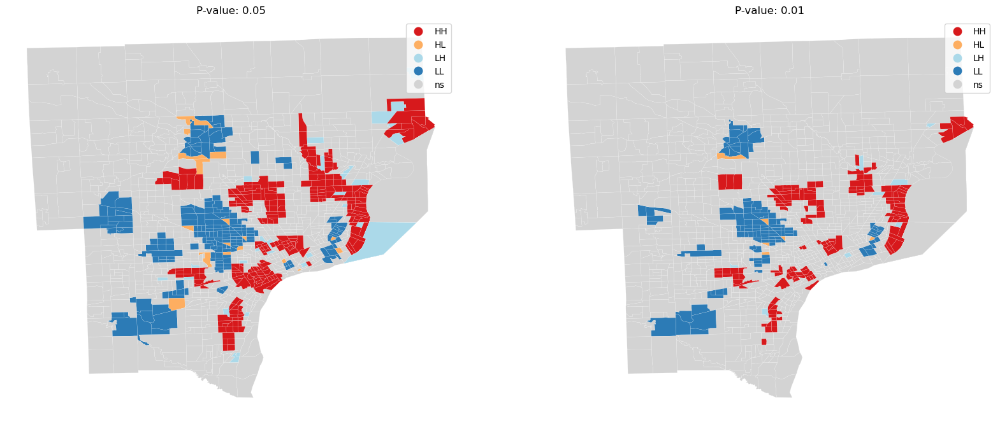

In [50]:
fig, ax = plt.subplots(1, 2, figsize=(20, 12))  # create the 1x2 subplots

lisa_cluster(lisa, service, p=0.05, ax=ax[0])   # Map of areas that have the confidence level of atleast 95% 
ax[0].axis("off")                               # Turning off axes for asthetics
ax[0].set_title("P-value: 0.05")                # Title of the map

lisa_cluster(lisa, service, p=0.01, ax=ax[1])   # Map of areas that have the confidence level of atleast 99%
ax[1].axis("off")                               # Turning off axes for asthetics
ax[1].set_title("P-value: 0.01")                # Title of the map

plt.show()

These graphs above map out the Moran's scatterplots above spatially for p = 0.05 and p = 0.01 values. The blue areas and red areas are both areas that are more likely to actually be overserved or underserved (respectively) as the surrounding areas are also similar too. When policymakers want to assess risk of transit development projects, they can use this analysis to help them achieve their goals. In the right map, the blue and red areas are low-risk, high-reward places meaning that transit changes to those places will have the intended benefits that is hoped for and the risk of it turning adverse is very low.